# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [3]:
# Pre-requisite: Select PyTorch 2.0.0 kernel

In [ ]:
# Rubric: https://review.udacity.com/#!/rubrics/4801/view


In [ ]:
# run this once to unzip the file
# !unzip processed-celeba-small.zip

In [2]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
from torchvision import datasets
import torchvision
import os
import multiprocessing
from tqdm import tqdm

import tests


In [7]:
data_dir = 'processed-celeba-small/celeba'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [4]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
        
    transforms = [
        torchvision.transforms.Resize(size),
        # transforms.RandomCrop(224),                
        # transforms.RandomHorizontalFlip(0.5),
        # transforms.RandomVerticalFlip(0.5),
        # transforms.RandAugment(
        #     num_ops=3,
        #     interpolation=transforms.InterpolationMode.BILINEAR
        # ),

        # transforms.RandomAutocontrast(0.5),
        # transforms.RandomApply(
        #     [transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1)],
        #     p=0.5
        # ),                        
        # transforms.AutoAugment(interpolation=transforms.InterpolationMode.BILINEAR),
        # transforms.FiveCrop(224),        
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ]        
    
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [5]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        # TODO: implement the init method
        
        self.directory = directory
        self.transforms = transforms
        self.extension = extension
        self.filenames = [f for f in os.listdir(directory) if f.endswith(extension)]


    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.filenames)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        
        filename = self.filenames[index]
        filepath = os.path.join(self.directory, filename)
        image = Image.open(filepath)
        
        if self.transforms:
            image = self.transforms(image)
        
        return image        

In [8]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

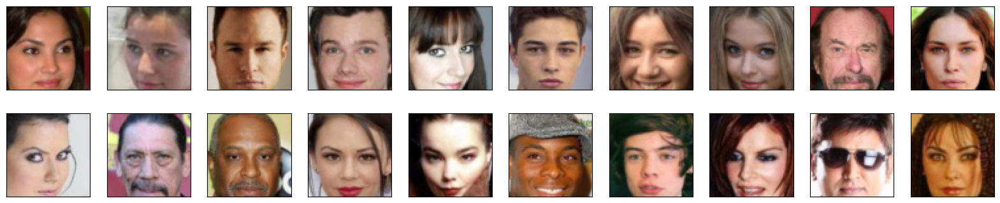

In [9]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [11]:
from torch.nn import Module
import torch.nn as nn
import torch.nn.functional as F

In [27]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a convolutional layer, with optional batch normalization.
    """
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, 
                           kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    
    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

class Discriminator(Module):
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        
        # Convolutional layers, increasing in depth
        # first layer has *no* batchnorm
        self.conv1 = conv(3, conv_dim, 4, batch_norm=False) # x, y = 64, depth 64  (64, 64, 3) -> (32, 32, 64)
        self.conv2 = conv(conv_dim, conv_dim*2, 4) # (32, 32, 128)                 (32, 32, 64) -> (16, 16, 128)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4) # (16, 16, 256)               (16, 16, 128) -> (8, 8, 256)
        self.conv4 = conv(conv_dim*4, conv_dim*8, 4) # (8, 8, 512)                 (8, 8, 256) -> (4, 4, 512)
        
        self.conv5 = conv(conv_dim*8, 1, 4, stride=1, padding=0, batch_norm=False) # (4, 4, 512) -> (1, 1, 1)    
        
        # self.activation = F.relu
        self.activation = nn.LeakyReLU(0.2)

        # self.flatten = nn.Flatten()        
        # self.fc = nn.Linear(4 * 4 * conv_dim * 8, 1)
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
        
        out = self.activation(self.conv1(x))
        out = self.activation(self.conv2(out))
        out = self.activation(self.conv3(out))
        out = self.activation(self.conv4(out))
        
        # out = self.flatten(out)
        # out = self.fc(out)
        
        # last, classification layer        
        out = self.conv5(out)
        
        return out

In [30]:
# discriminator = Discriminator()

# images = torch.randn(1, 3, 64, 64)
# score = discriminator(images)

# score.shape

In [28]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()

print(discriminator)
tests.check_discriminator(discriminator)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)
Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [56]:
# helper deconv function
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a transposed-convolutional layer, with optional batch normalization.
    """
    # create a sequence of transpose + optional batch norm layers
    layers = []
    transpose_conv_layer = nn.ConvTranspose2d(in_channels, out_channels, 
                                              kernel_size, stride, padding, bias=False)
    # append transpose convolutional layer
    layers.append(transpose_conv_layer)
    
    if batch_norm:
        # append batchnorm layer
        layers.append(nn.BatchNorm2d(out_channels))
        
    return nn.Sequential(*layers)

class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
        # TODO: instantiate the different layers
        
#         self.init_size = 4 # initial size before upsampling
#         self.img_size = 64 # final image size
        
#         self.l1 = nn.Sequential(
#             nn.Linear(latent_dim, 128 * self.init_size ** 2)
#         )
        
#         self.conv_blocks = nn.Sequential(
#             deconv(128, 128, 4, stride=2, padding=1),
#             deconv(128, 64, 4, stride=2, padding=1),  
#             nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1),
#             nn.Tanh(), 
#         )


        # First deconv layer: Takes latent vector input and outputs a feature map
        self.deconv1 = deconv(latent_dim, 1024, kernel_size=4, stride=1, padding=0, batch_norm=True)
        
        # Second deconv layer: Upsamples the feature map to a larger size
        self.deconv2 = deconv(1024, 512, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Third deconv layer
        self.deconv3 = deconv(512, 256, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fourth deconv layer
        self.deconv4 = deconv(256, 128, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fifth deconv layer: Outputs the final 64x64x3 image
        self.deconv5 = deconv(128, 3, kernel_size=4, stride=2, padding=1, batch_norm=False)


    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
#         out = self.l1(x)
#         out = out.view(out.shape[0], 128, self.init_size, self.init_size)
#         img = self.conv_blocks(out)
        
#         return img
        # print(f"GENERATOR deconv - tensor shape: {x.shape}")

      # Pass through each deconv layer with ReLU activation
        x = F.relu(self.deconv1(x))
        x = F.relu(self.deconv2(x))
        x = F.relu(self.deconv3(x))
        x = F.relu(self.deconv4(x))
        
        # Apply Tanh activation to the output of the final deconv layer
        x = torch.tanh(self.deconv5(x))
        
        return x

In [57]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [58]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):    
    lr = 0.0002
    betal=0.5
    beta2=0.999 # default value

    """ This function should return the optimizers of the generator and the discriminator """
    g_optimizer = optim.Adam(generator.parameters(), lr, [betal, beta2])
    d_optimizer = optim.Adam(discriminator.parameters(), lr, [betal, beta2])
    
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [42]:
def real_loss(D_out, device, smooth=False):
    batch_size = D_out.size(0)

    # label smoothing
    if smooth:
        # smooth, real labels = 0.9
        labels = torch.ones(batch_size)*0.9
    else:
        labels = torch.ones(batch_size) # real labels = 1

    labels = labels.to(device)
        
    # binary cross entropy with logits loss
    criterion = nn.BCEWithLogitsLoss()
    # calculate loss
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

def fake_loss(D_out, device):
    batch_size = D_out.size(0)
    
    labels = torch.zeros(batch_size) # fake labels = 0
    
    labels = labels.to(device)
    
    criterion = nn.BCEWithLogitsLoss()
    
    # calculate loss
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

In [ ]:
def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    # TODO: implement the generator loss 
    return loss

### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [ ]:
def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
    # TODO: implement the discriminator loss 
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [ ]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [ ]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    return {'loss': g_loss}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)
    return {'loss': d_loss, 'gp': gp}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [43]:
from datetime import datetime

In [65]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
device = 'cuda'

# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 128

In [66]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [61]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

Epoch [    1/   50] | d_loss: 1.4601 | g_loss: 2.6541
Epoch [    1/   50] | d_loss: 0.1792 | g_loss: 9.7870
Epoch [    1/   50] | d_loss: 1.0400 | g_loss: 1.3583
Epoch [    1/   50] | d_loss: 1.6130 | g_loss: 3.1289
Epoch [    1/   50] | d_loss: 0.8248 | g_loss: 2.0712
Epoch [    1/   50] | d_loss: 0.5969 | g_loss: 4.4193
Epoch [    1/   50] | d_loss: 1.0621 | g_loss: 2.2320
Epoch [    1/   50] | d_loss: 0.8260 | g_loss: 3.1650
Epoch [    1/   50] | d_loss: 0.1466 | g_loss: 3.9636
Epoch [    1/   50] | d_loss: 0.5971 | g_loss: 2.6083
Epoch [    1/   50] | d_loss: 1.8643 | g_loss: 2.9655


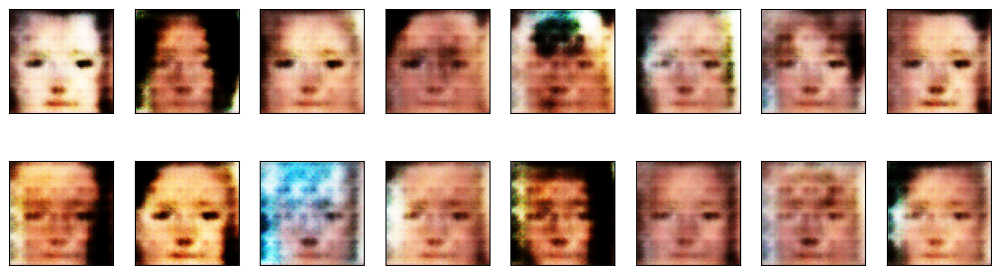

Epoch [    2/   50] | d_loss: 0.7251 | g_loss: 2.4346
Epoch [    2/   50] | d_loss: 1.0771 | g_loss: 3.4298
Epoch [    2/   50] | d_loss: 4.4811 | g_loss: 5.8987
Epoch [    2/   50] | d_loss: 0.9117 | g_loss: 2.5864
Epoch [    2/   50] | d_loss: 0.5027 | g_loss: 3.5607
Epoch [    2/   50] | d_loss: 0.5686 | g_loss: 4.6090
Epoch [    2/   50] | d_loss: 0.6596 | g_loss: 2.6505
Epoch [    2/   50] | d_loss: 0.2675 | g_loss: 1.9941
Epoch [    2/   50] | d_loss: 0.6909 | g_loss: 2.6164
Epoch [    2/   50] | d_loss: 0.5034 | g_loss: 2.1075
Epoch [    2/   50] | d_loss: 0.7606 | g_loss: 4.5663


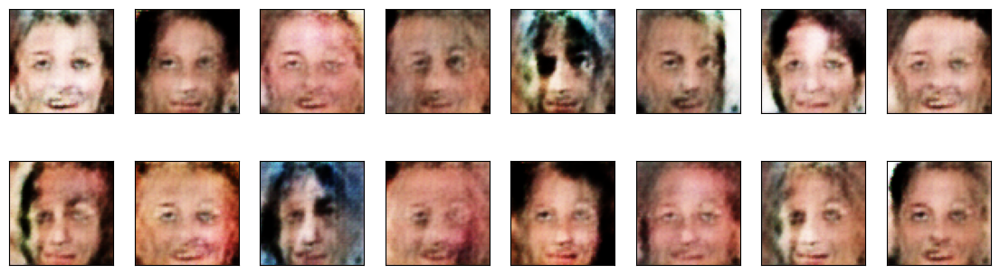

Epoch [    3/   50] | d_loss: 0.1586 | g_loss: 5.3051
Epoch [    3/   50] | d_loss: 0.2978 | g_loss: 2.4363
Epoch [    3/   50] | d_loss: 0.3771 | g_loss: 2.1805
Epoch [    3/   50] | d_loss: 0.7025 | g_loss: 3.9885
Epoch [    3/   50] | d_loss: 0.5208 | g_loss: 1.8877
Epoch [    3/   50] | d_loss: 0.3494 | g_loss: 2.0796
Epoch [    3/   50] | d_loss: 0.1998 | g_loss: 2.8697
Epoch [    3/   50] | d_loss: 0.3559 | g_loss: 2.5634
Epoch [    3/   50] | d_loss: 0.5112 | g_loss: 6.2741
Epoch [    3/   50] | d_loss: 0.5821 | g_loss: 6.0280
Epoch [    3/   50] | d_loss: 0.2330 | g_loss: 3.2536


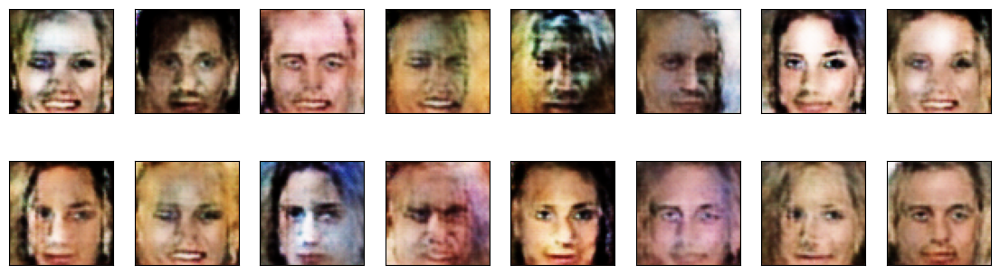

Epoch [    4/   50] | d_loss: 0.4675 | g_loss: 2.9816
Epoch [    4/   50] | d_loss: 0.3296 | g_loss: 2.8833
Epoch [    4/   50] | d_loss: 0.5485 | g_loss: 3.9535
Epoch [    4/   50] | d_loss: 0.4824 | g_loss: 2.8507
Epoch [    4/   50] | d_loss: 2.3423 | g_loss: 7.0603
Epoch [    4/   50] | d_loss: 0.1414 | g_loss: 3.0892
Epoch [    4/   50] | d_loss: 0.2788 | g_loss: 2.3399
Epoch [    4/   50] | d_loss: 0.1982 | g_loss: 3.1341
Epoch [    4/   50] | d_loss: 0.4840 | g_loss: 3.6557
Epoch [    4/   50] | d_loss: 0.2100 | g_loss: 2.9632
Epoch [    4/   50] | d_loss: 1.9393 | g_loss: 7.7467


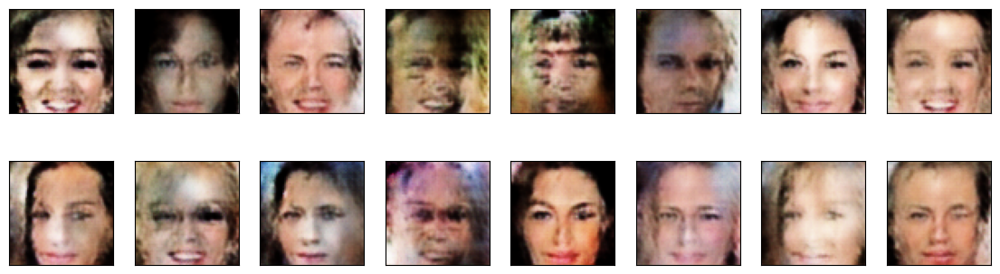

Epoch [    5/   50] | d_loss: 0.3927 | g_loss: 3.6293
Epoch [    5/   50] | d_loss: 0.6059 | g_loss: 4.5674
Epoch [    5/   50] | d_loss: 0.1926 | g_loss: 2.9646
Epoch [    5/   50] | d_loss: 0.7629 | g_loss: 7.4792
Epoch [    5/   50] | d_loss: 0.2404 | g_loss: 3.7472
Epoch [    5/   50] | d_loss: 0.1853 | g_loss: 4.4152
Epoch [    5/   50] | d_loss: 0.2718 | g_loss: 4.3269
Epoch [    5/   50] | d_loss: 0.2479 | g_loss: 3.9669
Epoch [    5/   50] | d_loss: 0.0900 | g_loss: 4.7147
Epoch [    5/   50] | d_loss: 0.0743 | g_loss: 4.6361
Epoch [    5/   50] | d_loss: 0.1914 | g_loss: 2.7352


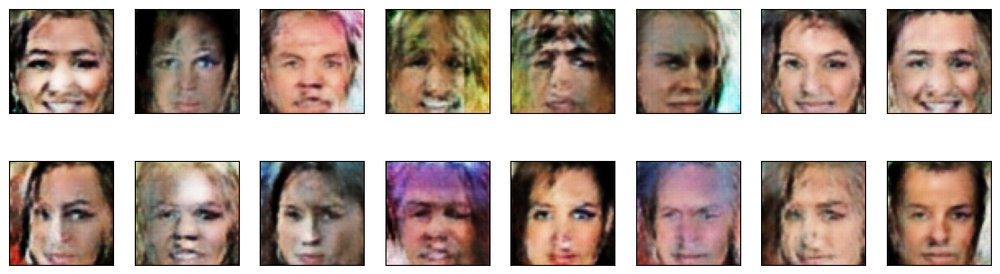

Epoch [    6/   50] | d_loss: 0.0910 | g_loss: 2.3860
Epoch [    6/   50] | d_loss: 0.0880 | g_loss: 5.4140
Epoch [    6/   50] | d_loss: 0.5793 | g_loss: 3.4414
Epoch [    6/   50] | d_loss: 0.0395 | g_loss: 5.9426
Epoch [    6/   50] | d_loss: 0.1986 | g_loss: 6.1983
Epoch [    6/   50] | d_loss: 0.1477 | g_loss: 4.1646
Epoch [    6/   50] | d_loss: 0.5371 | g_loss: 5.5543
Epoch [    6/   50] | d_loss: 0.2000 | g_loss: 3.7542
Epoch [    6/   50] | d_loss: 0.2693 | g_loss: 3.2382
Epoch [    6/   50] | d_loss: 0.3805 | g_loss: 3.1505
Epoch [    6/   50] | d_loss: 0.0615 | g_loss: 4.1030


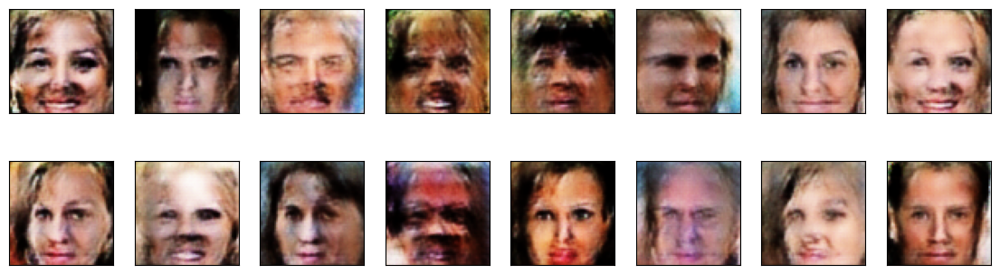

Epoch [    7/   50] | d_loss: 0.3250 | g_loss: 4.5297
Epoch [    7/   50] | d_loss: 0.2014 | g_loss: 4.4021
Epoch [    7/   50] | d_loss: 0.2830 | g_loss: 3.5854
Epoch [    7/   50] | d_loss: 0.0844 | g_loss: 3.7260
Epoch [    7/   50] | d_loss: 0.4468 | g_loss: 5.6175
Epoch [    7/   50] | d_loss: 0.0403 | g_loss: 5.1870
Epoch [    7/   50] | d_loss: 2.2673 | g_loss: 3.1682
Epoch [    7/   50] | d_loss: 0.3265 | g_loss: 6.5091
Epoch [    7/   50] | d_loss: 0.0185 | g_loss: 8.7649
Epoch [    7/   50] | d_loss: 0.0913 | g_loss: 2.8591
Epoch [    7/   50] | d_loss: 0.3269 | g_loss: 1.6725


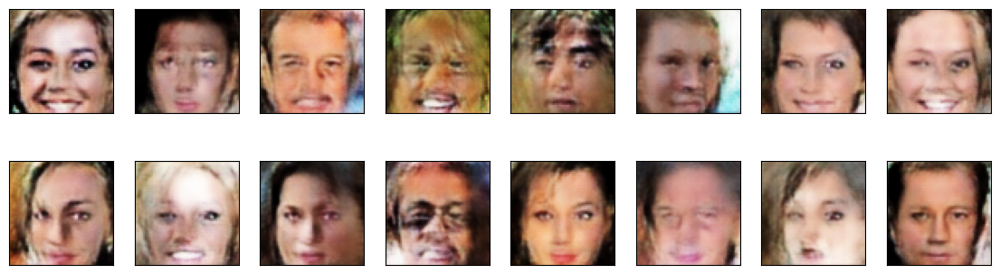

Epoch [    8/   50] | d_loss: 0.1972 | g_loss: 4.6780
Epoch [    8/   50] | d_loss: 0.2983 | g_loss: 2.0212
Epoch [    8/   50] | d_loss: 0.3004 | g_loss: 2.3885
Epoch [    8/   50] | d_loss: 1.8857 | g_loss: 4.1753
Epoch [    8/   50] | d_loss: 0.1578 | g_loss: 5.7332
Epoch [    8/   50] | d_loss: 0.0981 | g_loss: 4.6732
Epoch [    8/   50] | d_loss: 0.6458 | g_loss: 4.6505
Epoch [    8/   50] | d_loss: 3.7097 | g_loss: 2.7002
Epoch [    8/   50] | d_loss: 0.7868 | g_loss: 6.8889
Epoch [    8/   50] | d_loss: 0.0581 | g_loss: 4.8461
Epoch [    8/   50] | d_loss: 0.0721 | g_loss: 4.0900


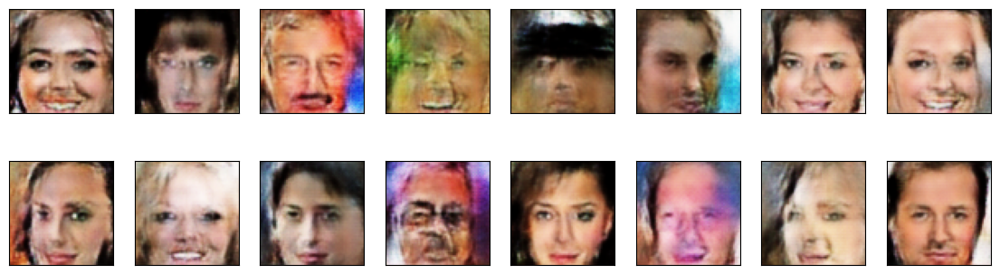

Epoch [    9/   50] | d_loss: 0.2200 | g_loss: 2.7148
Epoch [    9/   50] | d_loss: 0.0461 | g_loss: 3.7910
Epoch [    9/   50] | d_loss: 0.6324 | g_loss: 5.8936
Epoch [    9/   50] | d_loss: 0.7882 | g_loss: 5.1913
Epoch [    9/   50] | d_loss: 0.5637 | g_loss: 6.0870
Epoch [    9/   50] | d_loss: 0.1636 | g_loss: 4.7415
Epoch [    9/   50] | d_loss: 0.0554 | g_loss: 4.9885
Epoch [    9/   50] | d_loss: 0.3072 | g_loss: 4.3963
Epoch [    9/   50] | d_loss: 0.0866 | g_loss: 3.9932
Epoch [    9/   50] | d_loss: 0.2548 | g_loss: 2.8718
Epoch [    9/   50] | d_loss: 0.0312 | g_loss: 5.3194


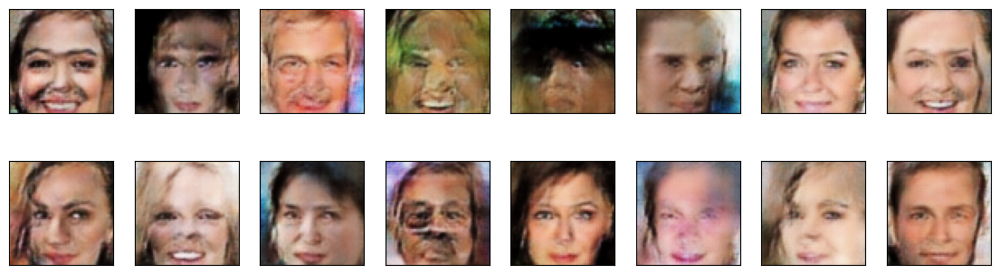

Epoch [   10/   50] | d_loss: 0.0657 | g_loss: 8.9014
Epoch [   10/   50] | d_loss: 0.6807 | g_loss: 6.7340
Epoch [   10/   50] | d_loss: 0.1044 | g_loss: 3.4859
Epoch [   10/   50] | d_loss: 0.0459 | g_loss: 4.4212
Epoch [   10/   50] | d_loss: 1.8460 | g_loss: 7.9338
Epoch [   10/   50] | d_loss: 0.0793 | g_loss: 3.3200
Epoch [   10/   50] | d_loss: 0.4313 | g_loss: 7.9407
Epoch [   10/   50] | d_loss: 0.2492 | g_loss: 4.2506
Epoch [   10/   50] | d_loss: 0.1978 | g_loss: 3.9894
Epoch [   10/   50] | d_loss: 0.0634 | g_loss: 4.6271
Epoch [   10/   50] | d_loss: 0.1415 | g_loss: 4.1877


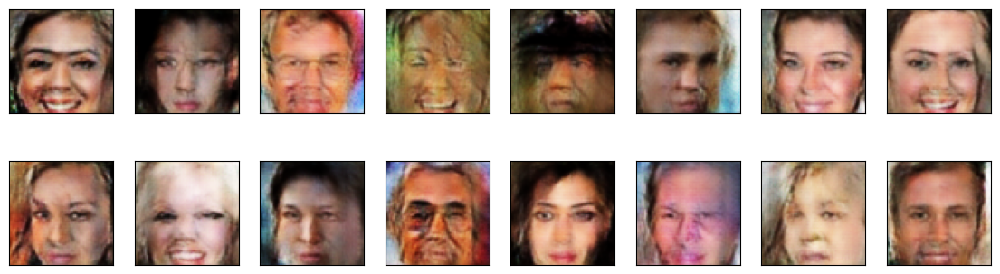

Epoch [   11/   50] | d_loss: 1.0562 | g_loss: 6.2570
Epoch [   11/   50] | d_loss: 0.0983 | g_loss: 6.6464
Epoch [   11/   50] | d_loss: 0.0196 | g_loss: 4.9917
Epoch [   11/   50] | d_loss: 0.0104 | g_loss: 9.8454
Epoch [   11/   50] | d_loss: 0.3224 | g_loss: 4.6519
Epoch [   11/   50] | d_loss: 0.1662 | g_loss: 2.2111
Epoch [   11/   50] | d_loss: 0.0502 | g_loss: 3.4845
Epoch [   11/   50] | d_loss: 0.4289 | g_loss: 4.9486
Epoch [   11/   50] | d_loss: 0.1598 | g_loss: 4.3927
Epoch [   11/   50] | d_loss: 0.0826 | g_loss: 2.7015
Epoch [   11/   50] | d_loss: 0.0917 | g_loss: 3.9925


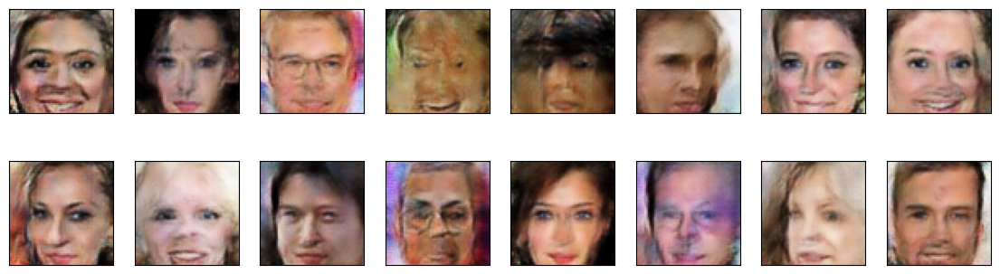

Epoch [   12/   50] | d_loss: 0.2860 | g_loss: 2.7798
Epoch [   12/   50] | d_loss: 0.1647 | g_loss: 2.4135
Epoch [   12/   50] | d_loss: 0.0398 | g_loss: 4.2880
Epoch [   12/   50] | d_loss: 0.1044 | g_loss: 3.1889
Epoch [   12/   50] | d_loss: 0.0453 | g_loss: 3.7314
Epoch [   12/   50] | d_loss: 0.0349 | g_loss: 8.1374
Epoch [   12/   50] | d_loss: 0.8930 | g_loss: 6.6036
Epoch [   12/   50] | d_loss: 0.0745 | g_loss: 6.5496
Epoch [   12/   50] | d_loss: 0.0326 | g_loss: 2.8618
Epoch [   12/   50] | d_loss: 0.0334 | g_loss: 6.2995
Epoch [   12/   50] | d_loss: 0.0514 | g_loss: 3.8165


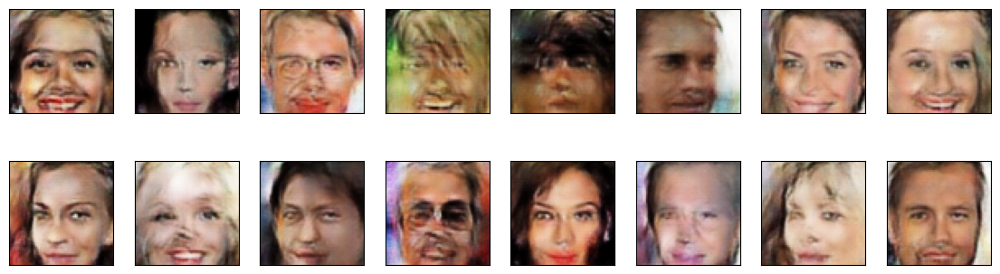

Epoch [   13/   50] | d_loss: 0.0107 | g_loss: 0.5877
Epoch [   13/   50] | d_loss: 0.1380 | g_loss: 6.5094
Epoch [   13/   50] | d_loss: 0.2142 | g_loss: 5.0701
Epoch [   13/   50] | d_loss: 0.6590 | g_loss: 3.4401
Epoch [   13/   50] | d_loss: 0.0884 | g_loss: 4.9583
Epoch [   13/   50] | d_loss: 0.3852 | g_loss: 3.8561
Epoch [   13/   50] | d_loss: 0.6909 | g_loss: 7.2047
Epoch [   13/   50] | d_loss: 0.1867 | g_loss: 2.9396
Epoch [   13/   50] | d_loss: 0.1597 | g_loss: 1.9661
Epoch [   13/   50] | d_loss: 0.0688 | g_loss: 6.4404
Epoch [   13/   50] | d_loss: 0.0568 | g_loss: 4.9455


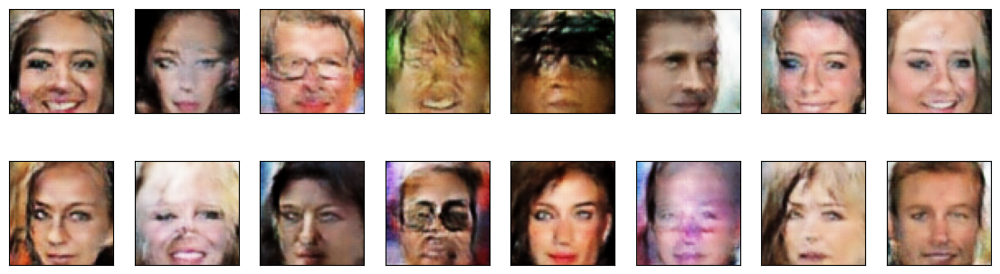

Epoch [   14/   50] | d_loss: 0.2164 | g_loss: 4.3052
Epoch [   14/   50] | d_loss: 0.1469 | g_loss: 4.3564
Epoch [   14/   50] | d_loss: 0.1266 | g_loss: 3.3903
Epoch [   14/   50] | d_loss: 0.1655 | g_loss: 6.8090
Epoch [   14/   50] | d_loss: 0.1414 | g_loss: 8.4012
Epoch [   14/   50] | d_loss: 0.0689 | g_loss: 5.5506
Epoch [   14/   50] | d_loss: 0.0052 | g_loss: 6.9144
Epoch [   14/   50] | d_loss: 0.6629 | g_loss: 6.4877
Epoch [   14/   50] | d_loss: 0.4125 | g_loss: 5.2668
Epoch [   14/   50] | d_loss: 0.0534 | g_loss: 2.9319
Epoch [   14/   50] | d_loss: 0.0546 | g_loss: 6.3433


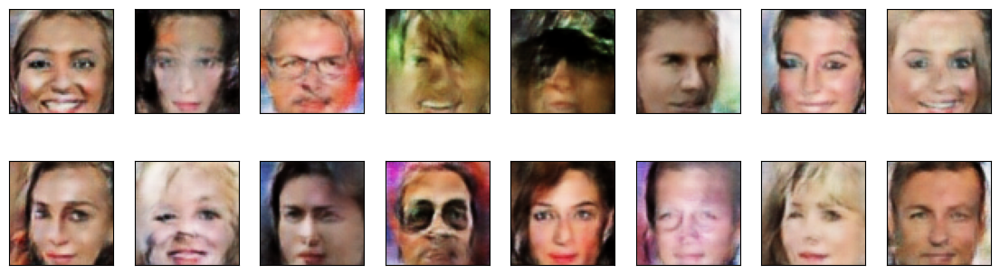

Epoch [   15/   50] | d_loss: 0.0307 | g_loss: 3.6227
Epoch [   15/   50] | d_loss: 0.4213 | g_loss: 5.5761
Epoch [   15/   50] | d_loss: 0.0730 | g_loss: 2.5444
Epoch [   15/   50] | d_loss: 0.0985 | g_loss: 4.2801
Epoch [   15/   50] | d_loss: 0.0687 | g_loss: 5.5720
Epoch [   15/   50] | d_loss: 0.4309 | g_loss: 7.0931
Epoch [   15/   50] | d_loss: 1.0664 | g_loss: 9.8417
Epoch [   15/   50] | d_loss: 0.2039 | g_loss: 4.0019
Epoch [   15/   50] | d_loss: 0.0672 | g_loss: 1.8772
Epoch [   15/   50] | d_loss: 0.6235 | g_loss: 8.8690
Epoch [   15/   50] | d_loss: 0.1012 | g_loss: 3.9991


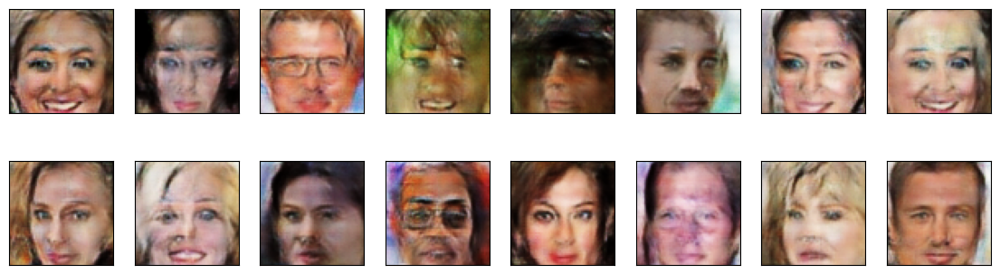

Epoch [   16/   50] | d_loss: 0.0765 | g_loss: 3.4812
Epoch [   16/   50] | d_loss: 0.1465 | g_loss: 4.1012
Epoch [   16/   50] | d_loss: 0.0728 | g_loss: 5.5770
Epoch [   16/   50] | d_loss: 0.0847 | g_loss: 7.0723
Epoch [   16/   50] | d_loss: 0.0451 | g_loss: 4.8895
Epoch [   16/   50] | d_loss: 0.1860 | g_loss: 8.4133
Epoch [   16/   50] | d_loss: 0.1910 | g_loss: 4.3928
Epoch [   16/   50] | d_loss: 0.1155 | g_loss: 5.0637
Epoch [   16/   50] | d_loss: 0.1183 | g_loss: 3.7764
Epoch [   16/   50] | d_loss: 0.0560 | g_loss: 4.4317
Epoch [   16/   50] | d_loss: 0.0970 | g_loss: 3.0124


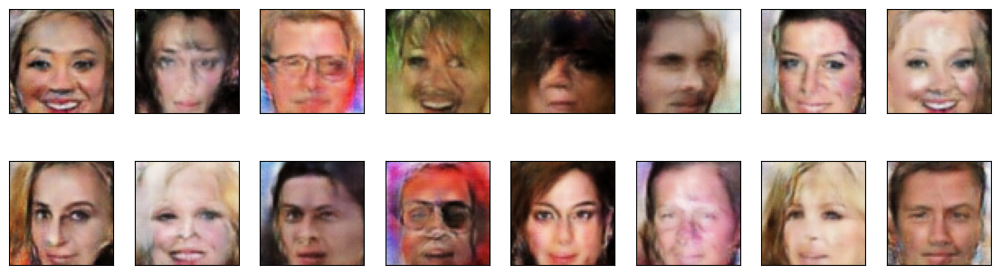

Epoch [   17/   50] | d_loss: 0.3646 | g_loss: 8.4920
Epoch [   17/   50] | d_loss: 0.1486 | g_loss: 5.3036
Epoch [   17/   50] | d_loss: 0.0765 | g_loss: 4.5569
Epoch [   17/   50] | d_loss: 0.3267 | g_loss: 3.4257
Epoch [   17/   50] | d_loss: 0.2017 | g_loss: 7.3041
Epoch [   17/   50] | d_loss: 0.1224 | g_loss: 3.8894
Epoch [   17/   50] | d_loss: 0.0886 | g_loss: 3.7756
Epoch [   17/   50] | d_loss: 0.0624 | g_loss: 5.2495
Epoch [   17/   50] | d_loss: 0.1928 | g_loss: 6.1053
Epoch [   17/   50] | d_loss: 0.5374 | g_loss: 8.3418
Epoch [   17/   50] | d_loss: 0.2171 | g_loss: 5.9521


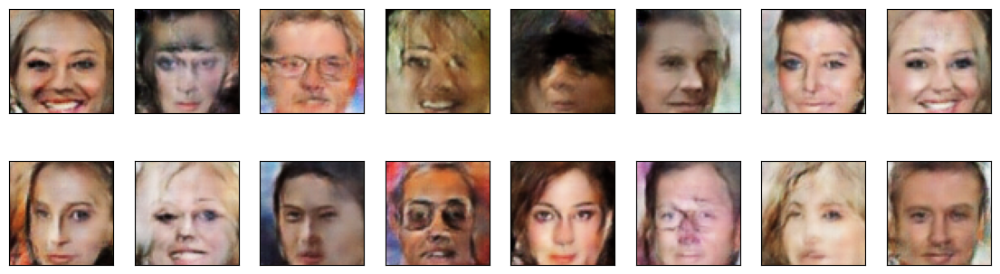

Epoch [   18/   50] | d_loss: 0.1345 | g_loss: 5.2315
Epoch [   18/   50] | d_loss: 0.3575 | g_loss: 4.2964
Epoch [   18/   50] | d_loss: 0.1814 | g_loss: 4.3313
Epoch [   18/   50] | d_loss: 0.0888 | g_loss: 3.8058
Epoch [   18/   50] | d_loss: 0.0164 | g_loss: 6.0772
Epoch [   18/   50] | d_loss: 0.1916 | g_loss: 3.9631
Epoch [   18/   50] | d_loss: 0.2576 | g_loss: 5.2221
Epoch [   18/   50] | d_loss: 0.0406 | g_loss: 6.5871
Epoch [   18/   50] | d_loss: 0.0394 | g_loss: 6.0510
Epoch [   18/   50] | d_loss: 0.1237 | g_loss: 4.8966
Epoch [   18/   50] | d_loss: 0.6325 | g_loss: 4.6526


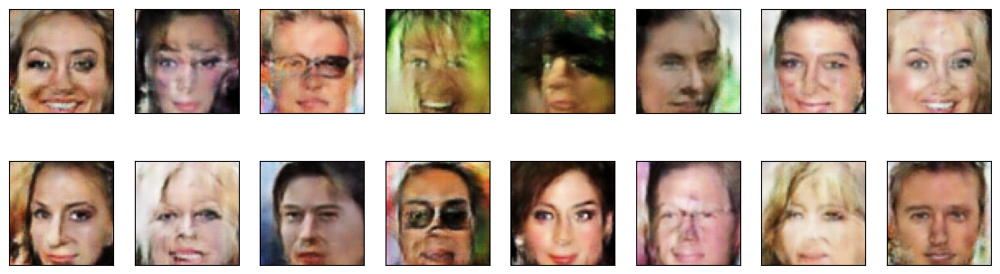

Epoch [   19/   50] | d_loss: 0.1108 | g_loss: 7.2050
Epoch [   19/   50] | d_loss: 0.3423 | g_loss: 5.1517
Epoch [   19/   50] | d_loss: 0.1118 | g_loss: 4.0691
Epoch [   19/   50] | d_loss: 0.1214 | g_loss: 3.1544
Epoch [   19/   50] | d_loss: 0.1175 | g_loss: 7.2784
Epoch [   19/   50] | d_loss: 4.0038 | g_loss: 2.6216
Epoch [   19/   50] | d_loss: 0.9270 | g_loss: 3.9589
Epoch [   19/   50] | d_loss: 0.3610 | g_loss: 6.6767
Epoch [   19/   50] | d_loss: 0.3777 | g_loss: 4.8393
Epoch [   19/   50] | d_loss: 0.1585 | g_loss: 4.5526
Epoch [   19/   50] | d_loss: 0.1586 | g_loss: 5.6358


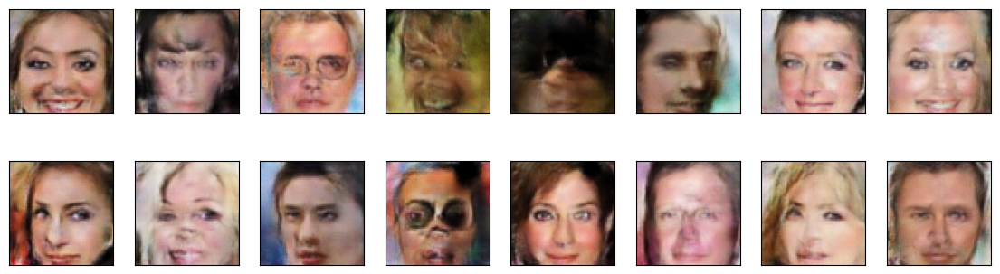

Epoch [   20/   50] | d_loss: 0.0537 | g_loss: 6.0559
Epoch [   20/   50] | d_loss: 0.0732 | g_loss: 2.7632
Epoch [   20/   50] | d_loss: 1.6410 | g_loss: 0.3577
Epoch [   20/   50] | d_loss: 1.3433 | g_loss: 4.8993
Epoch [   20/   50] | d_loss: 0.2125 | g_loss: 4.3536
Epoch [   20/   50] | d_loss: 0.2061 | g_loss: 4.0124
Epoch [   20/   50] | d_loss: 0.4009 | g_loss: 5.3536
Epoch [   20/   50] | d_loss: 0.0546 | g_loss: 4.1288
Epoch [   20/   50] | d_loss: 0.0669 | g_loss: 4.5849
Epoch [   20/   50] | d_loss: 0.0240 | g_loss: 6.3162
Epoch [   20/   50] | d_loss: 0.4315 | g_loss: 3.7163


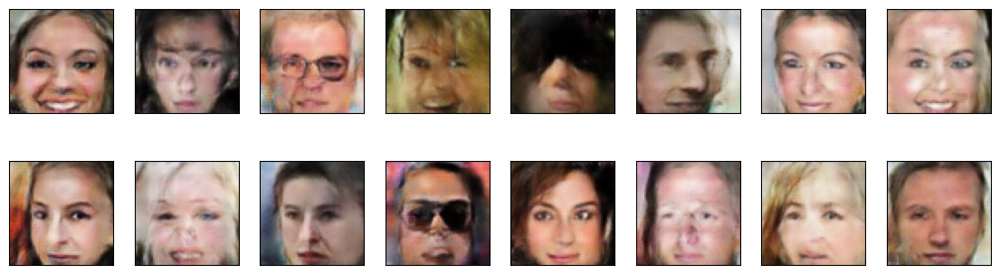

Epoch [   21/   50] | d_loss: 0.3258 | g_loss: 3.7776
Epoch [   21/   50] | d_loss: 0.1862 | g_loss: 5.5895
Epoch [   21/   50] | d_loss: 0.5223 | g_loss: 7.1018
Epoch [   21/   50] | d_loss: 0.2164 | g_loss: 6.0108
Epoch [   21/   50] | d_loss: 0.1808 | g_loss: 5.1666
Epoch [   21/   50] | d_loss: 0.0483 | g_loss: 4.2089
Epoch [   21/   50] | d_loss: 0.1030 | g_loss: 6.1809
Epoch [   21/   50] | d_loss: 0.1174 | g_loss: 4.7822
Epoch [   21/   50] | d_loss: 0.0745 | g_loss: 3.9462
Epoch [   21/   50] | d_loss: 0.0490 | g_loss: 5.0163
Epoch [   21/   50] | d_loss: 0.3696 | g_loss: 9.2990


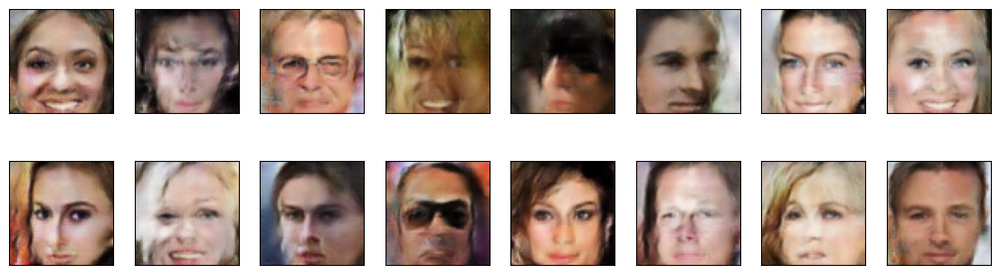

Epoch [   22/   50] | d_loss: 0.0936 | g_loss: 2.9324
Epoch [   22/   50] | d_loss: 0.4400 | g_loss: 5.7378
Epoch [   22/   50] | d_loss: 0.0887 | g_loss: 2.5393
Epoch [   22/   50] | d_loss: 0.0663 | g_loss: 4.2009
Epoch [   22/   50] | d_loss: 0.3249 | g_loss: 7.5935
Epoch [   22/   50] | d_loss: 0.1299 | g_loss: 6.5659
Epoch [   22/   50] | d_loss: 0.0543 | g_loss: 3.9491
Epoch [   22/   50] | d_loss: 0.2635 | g_loss: 3.5191
Epoch [   22/   50] | d_loss: 0.3097 | g_loss: 2.8001
Epoch [   22/   50] | d_loss: 0.2313 | g_loss: 4.2594
Epoch [   22/   50] | d_loss: 0.2377 | g_loss: 6.9981


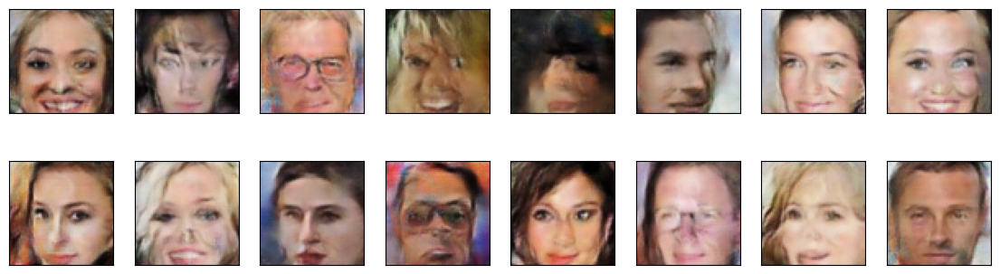

Epoch [   23/   50] | d_loss: 0.0626 | g_loss: 4.3781
Epoch [   23/   50] | d_loss: 0.1046 | g_loss: 5.9218
Epoch [   23/   50] | d_loss: 0.0126 | g_loss: 7.5918
Epoch [   23/   50] | d_loss: 2.0188 | g_loss: 7.0871
Epoch [   23/   50] | d_loss: 0.0714 | g_loss: 4.0229
Epoch [   23/   50] | d_loss: 0.1321 | g_loss: 6.2783
Epoch [   23/   50] | d_loss: 0.5173 | g_loss: 5.6046
Epoch [   23/   50] | d_loss: 0.7870 | g_loss: 6.6504
Epoch [   23/   50] | d_loss: 0.0134 | g_loss: 6.1194
Epoch [   23/   50] | d_loss: 0.1084 | g_loss: 5.6420
Epoch [   23/   50] | d_loss: 0.0673 | g_loss: 3.3931


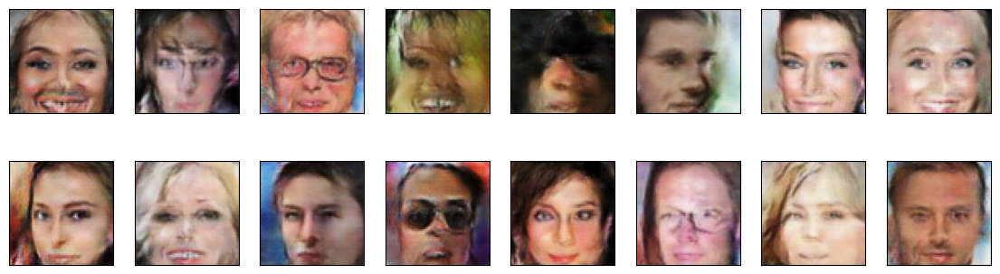

Epoch [   24/   50] | d_loss: 1.4724 | g_loss: 10.7506
Epoch [   24/   50] | d_loss: 0.1677 | g_loss: 3.3537
Epoch [   24/   50] | d_loss: 0.0742 | g_loss: 3.6675
Epoch [   24/   50] | d_loss: 0.0828 | g_loss: 3.9027
Epoch [   24/   50] | d_loss: 2.3305 | g_loss: 4.1202
Epoch [   24/   50] | d_loss: 0.1604 | g_loss: 3.7680
Epoch [   24/   50] | d_loss: 0.1192 | g_loss: 4.8779
Epoch [   24/   50] | d_loss: 0.0437 | g_loss: 6.3026
Epoch [   24/   50] | d_loss: 1.2260 | g_loss: 13.5683
Epoch [   24/   50] | d_loss: 0.1721 | g_loss: 3.1274
Epoch [   24/   50] | d_loss: 0.1253 | g_loss: 4.5111


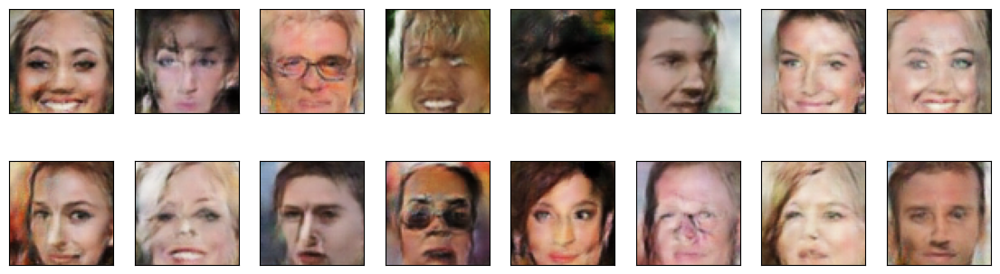

Epoch [   25/   50] | d_loss: 0.0888 | g_loss: 5.4672
Epoch [   25/   50] | d_loss: 0.4424 | g_loss: 2.7324
Epoch [   25/   50] | d_loss: 0.1301 | g_loss: 1.3549
Epoch [   25/   50] | d_loss: 0.2963 | g_loss: 4.6109
Epoch [   25/   50] | d_loss: 0.0975 | g_loss: 4.2986
Epoch [   25/   50] | d_loss: 1.6752 | g_loss: 2.2431
Epoch [   25/   50] | d_loss: 0.1440 | g_loss: 3.7364
Epoch [   25/   50] | d_loss: 0.2083 | g_loss: 2.3641
Epoch [   25/   50] | d_loss: 1.0620 | g_loss: 8.6227
Epoch [   25/   50] | d_loss: 0.1014 | g_loss: 5.7880
Epoch [   25/   50] | d_loss: 0.2257 | g_loss: 4.4852


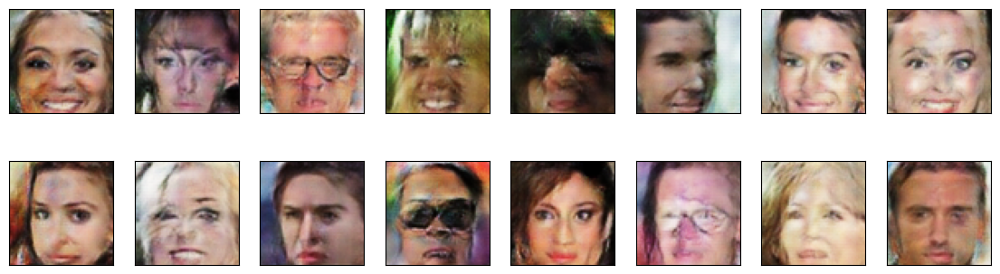

Epoch [   26/   50] | d_loss: 0.1191 | g_loss: 3.4516
Epoch [   26/   50] | d_loss: 0.1066 | g_loss: 5.0062
Epoch [   26/   50] | d_loss: 0.0850 | g_loss: 4.3960
Epoch [   26/   50] | d_loss: 0.0315 | g_loss: 5.2347
Epoch [   26/   50] | d_loss: 0.0205 | g_loss: 7.1169
Epoch [   26/   50] | d_loss: 0.0559 | g_loss: 4.9483
Epoch [   26/   50] | d_loss: 0.0468 | g_loss: 4.5000
Epoch [   26/   50] | d_loss: 1.0798 | g_loss: 2.0493
Epoch [   26/   50] | d_loss: 0.1190 | g_loss: 7.7472
Epoch [   26/   50] | d_loss: 0.0868 | g_loss: 3.7937
Epoch [   26/   50] | d_loss: 0.0797 | g_loss: 3.9327


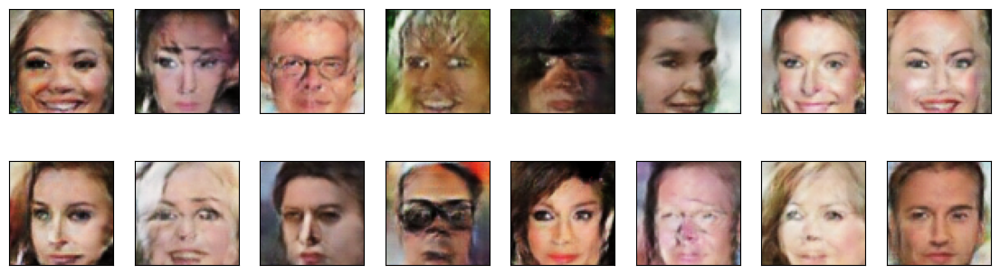

Epoch [   27/   50] | d_loss: 0.1592 | g_loss: 6.3506
Epoch [   27/   50] | d_loss: 0.0691 | g_loss: 3.5398
Epoch [   27/   50] | d_loss: 0.0532 | g_loss: 3.8154
Epoch [   27/   50] | d_loss: 0.0673 | g_loss: 4.0136
Epoch [   27/   50] | d_loss: 0.2129 | g_loss: 2.8757
Epoch [   27/   50] | d_loss: 0.0488 | g_loss: 3.2394
Epoch [   27/   50] | d_loss: 0.4123 | g_loss: 7.8514
Epoch [   27/   50] | d_loss: 0.5549 | g_loss: 3.3495
Epoch [   27/   50] | d_loss: 0.6515 | g_loss: 4.6255
Epoch [   27/   50] | d_loss: 0.2387 | g_loss: 3.9148
Epoch [   27/   50] | d_loss: 0.1330 | g_loss: 3.9701


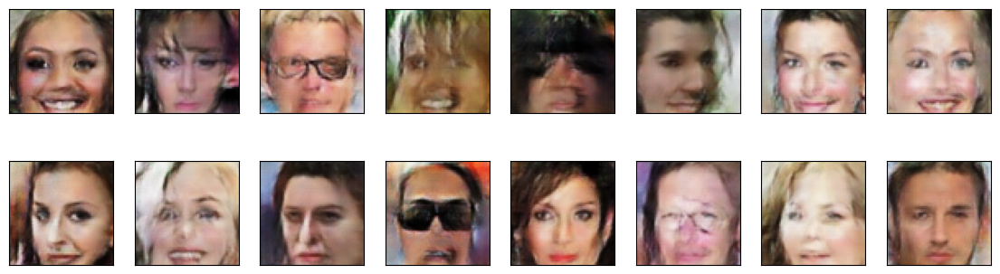

Epoch [   28/   50] | d_loss: 0.0454 | g_loss: 2.2680
Epoch [   28/   50] | d_loss: 0.2815 | g_loss: 3.7189
Epoch [   28/   50] | d_loss: 0.1702 | g_loss: 5.5739
Epoch [   28/   50] | d_loss: 0.0304 | g_loss: 4.7020
Epoch [   28/   50] | d_loss: 0.1562 | g_loss: 3.7932
Epoch [   28/   50] | d_loss: 0.0784 | g_loss: 7.3517
Epoch [   28/   50] | d_loss: 0.7620 | g_loss: 5.0400
Epoch [   28/   50] | d_loss: 0.2384 | g_loss: 3.4680
Epoch [   28/   50] | d_loss: 0.2978 | g_loss: 3.6050
Epoch [   28/   50] | d_loss: 0.4200 | g_loss: 5.5294
Epoch [   28/   50] | d_loss: 0.1277 | g_loss: 5.4152


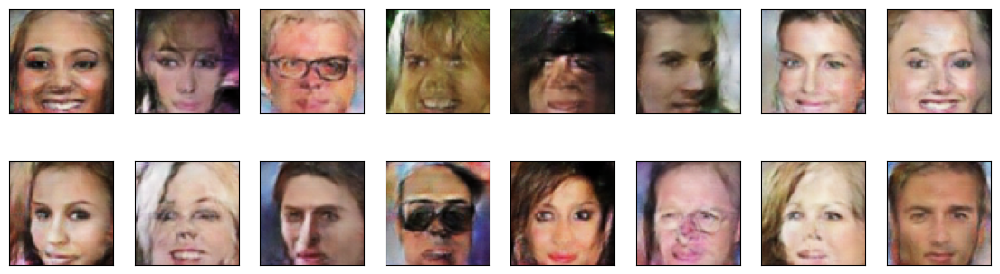

Epoch [   29/   50] | d_loss: 0.0407 | g_loss: 2.6355
Epoch [   29/   50] | d_loss: 0.1820 | g_loss: 5.8246
Epoch [   29/   50] | d_loss: 0.0821 | g_loss: 3.3495
Epoch [   29/   50] | d_loss: 0.0706 | g_loss: 3.0435
Epoch [   29/   50] | d_loss: 0.1517 | g_loss: 5.3693
Epoch [   29/   50] | d_loss: 0.3461 | g_loss: 3.4921
Epoch [   29/   50] | d_loss: 0.1300 | g_loss: 3.6325
Epoch [   29/   50] | d_loss: 0.3015 | g_loss: 4.3311
Epoch [   29/   50] | d_loss: 0.2153 | g_loss: 6.1252
Epoch [   29/   50] | d_loss: 0.2108 | g_loss: 5.9628
Epoch [   29/   50] | d_loss: 0.2321 | g_loss: 3.2407


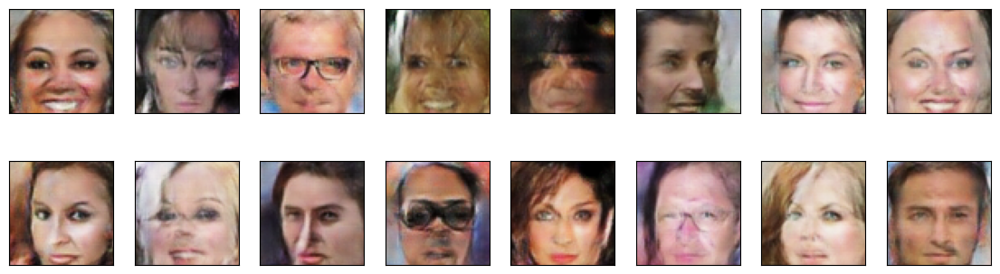

Epoch [   30/   50] | d_loss: 0.3627 | g_loss: 2.9905
Epoch [   30/   50] | d_loss: 0.1472 | g_loss: 4.2638
Epoch [   30/   50] | d_loss: 0.2235 | g_loss: 3.9148
Epoch [   30/   50] | d_loss: 0.4013 | g_loss: 2.6066
Epoch [   30/   50] | d_loss: 0.2029 | g_loss: 2.5441
Epoch [   30/   50] | d_loss: 0.2430 | g_loss: 5.3750
Epoch [   30/   50] | d_loss: 0.0646 | g_loss: 5.3427
Epoch [   30/   50] | d_loss: 1.3557 | g_loss: 2.0307
Epoch [   30/   50] | d_loss: 0.0480 | g_loss: 6.1291
Epoch [   30/   50] | d_loss: 0.3342 | g_loss: 4.8391
Epoch [   30/   50] | d_loss: 0.0736 | g_loss: 4.4960


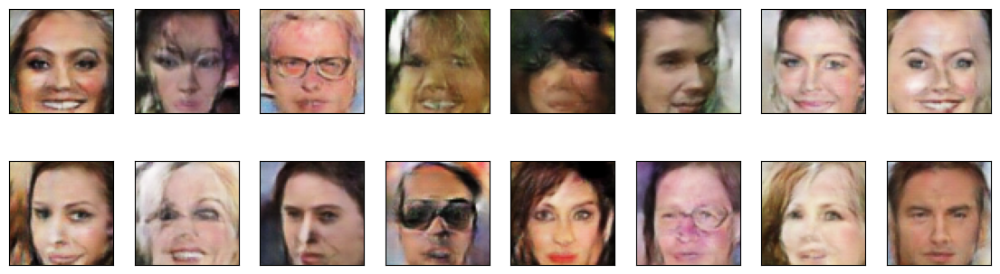

Epoch [   31/   50] | d_loss: 0.1080 | g_loss: 8.9028
Epoch [   31/   50] | d_loss: 0.0447 | g_loss: 3.8942
Epoch [   31/   50] | d_loss: 0.0248 | g_loss: 3.4022
Epoch [   31/   50] | d_loss: 0.2022 | g_loss: 5.5837
Epoch [   31/   50] | d_loss: 0.0346 | g_loss: 3.3738
Epoch [   31/   50] | d_loss: 0.0626 | g_loss: 7.8058
Epoch [   31/   50] | d_loss: 0.0543 | g_loss: 6.1745
Epoch [   31/   50] | d_loss: 0.2586 | g_loss: 1.5657
Epoch [   31/   50] | d_loss: 0.2460 | g_loss: 4.7022
Epoch [   31/   50] | d_loss: 0.1858 | g_loss: 3.6041
Epoch [   31/   50] | d_loss: 0.2781 | g_loss: 3.3332


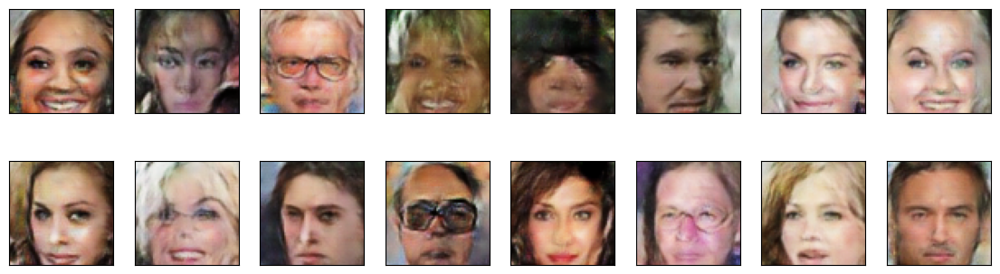

Epoch [   32/   50] | d_loss: 0.0271 | g_loss: 6.5041
Epoch [   32/   50] | d_loss: 0.1622 | g_loss: 5.2023
Epoch [   32/   50] | d_loss: 0.0273 | g_loss: 2.5041
Epoch [   32/   50] | d_loss: 0.0358 | g_loss: 4.2466
Epoch [   32/   50] | d_loss: 0.0471 | g_loss: 4.9500
Epoch [   32/   50] | d_loss: 0.0088 | g_loss: 4.8195
Epoch [   32/   50] | d_loss: 0.1998 | g_loss: 2.6286
Epoch [   32/   50] | d_loss: 0.3005 | g_loss: 5.5529
Epoch [   32/   50] | d_loss: 0.1130 | g_loss: 2.9567
Epoch [   32/   50] | d_loss: 0.5187 | g_loss: 3.9779
Epoch [   32/   50] | d_loss: 0.2222 | g_loss: 4.1441


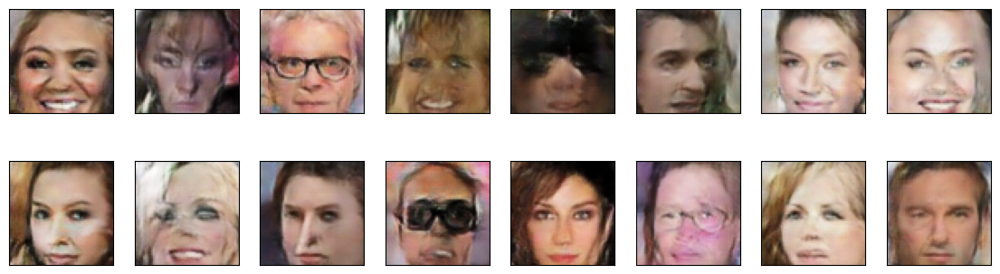

Epoch [   33/   50] | d_loss: 0.1701 | g_loss: 7.2031
Epoch [   33/   50] | d_loss: 0.0757 | g_loss: 3.0564
Epoch [   33/   50] | d_loss: 0.0798 | g_loss: 3.1544
Epoch [   33/   50] | d_loss: 0.1162 | g_loss: 5.1449
Epoch [   33/   50] | d_loss: 0.0361 | g_loss: 6.1489
Epoch [   33/   50] | d_loss: 0.2045 | g_loss: 5.1539
Epoch [   33/   50] | d_loss: 1.6253 | g_loss: 11.2850
Epoch [   33/   50] | d_loss: 0.4332 | g_loss: 2.0283
Epoch [   33/   50] | d_loss: 0.0755 | g_loss: 4.4990
Epoch [   33/   50] | d_loss: 0.4123 | g_loss: 1.8799
Epoch [   33/   50] | d_loss: 0.0197 | g_loss: 3.9617


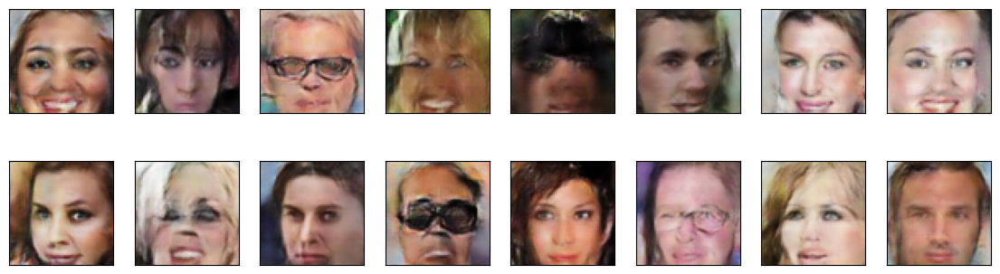

Epoch [   34/   50] | d_loss: 0.1622 | g_loss: 6.6711
Epoch [   34/   50] | d_loss: 0.7478 | g_loss: 2.1075
Epoch [   34/   50] | d_loss: 0.3636 | g_loss: 7.8725
Epoch [   34/   50] | d_loss: 0.0443 | g_loss: 5.3472
Epoch [   34/   50] | d_loss: 0.1122 | g_loss: 3.3185
Epoch [   34/   50] | d_loss: 0.1425 | g_loss: 3.4124
Epoch [   34/   50] | d_loss: 0.0356 | g_loss: 3.9613
Epoch [   34/   50] | d_loss: 0.0629 | g_loss: 5.5815
Epoch [   34/   50] | d_loss: 0.0210 | g_loss: 5.2000
Epoch [   34/   50] | d_loss: 0.0120 | g_loss: 4.1079
Epoch [   34/   50] | d_loss: 0.1065 | g_loss: 3.2608


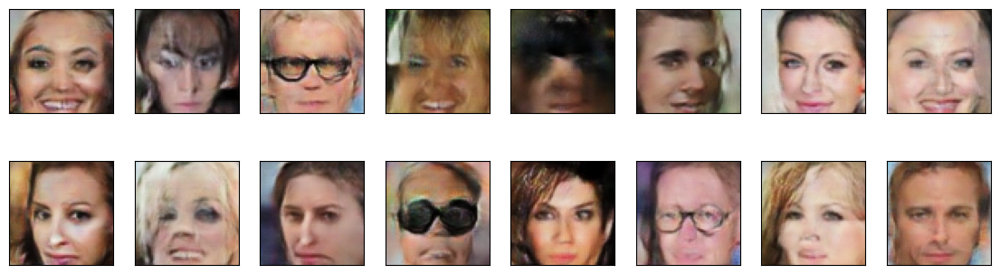

Epoch [   35/   50] | d_loss: 0.1375 | g_loss: 4.4582
Epoch [   35/   50] | d_loss: 0.0090 | g_loss: 2.1355
Epoch [   35/   50] | d_loss: 0.0840 | g_loss: 2.8383
Epoch [   35/   50] | d_loss: 0.5523 | g_loss: 2.0358
Epoch [   35/   50] | d_loss: 0.3442 | g_loss: 7.2909
Epoch [   35/   50] | d_loss: 0.1250 | g_loss: 3.9875
Epoch [   35/   50] | d_loss: 0.0379 | g_loss: 4.7028
Epoch [   35/   50] | d_loss: 0.0199 | g_loss: 3.9048
Epoch [   35/   50] | d_loss: 0.3922 | g_loss: 7.3373
Epoch [   35/   50] | d_loss: 0.0322 | g_loss: 5.6220
Epoch [   35/   50] | d_loss: 0.0602 | g_loss: 5.2435


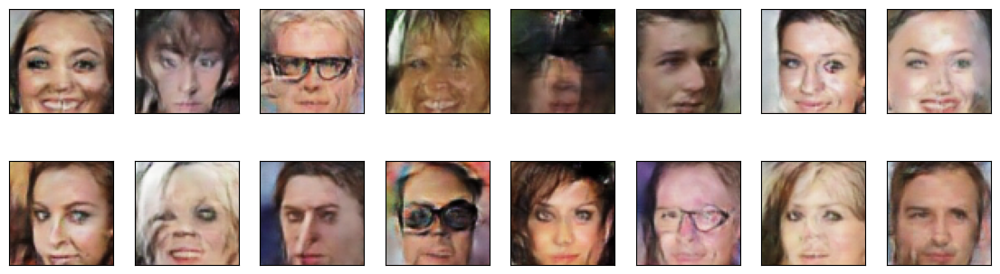

Epoch [   36/   50] | d_loss: 0.0149 | g_loss: 2.6795
Epoch [   36/   50] | d_loss: 0.0177 | g_loss: 6.1315
Epoch [   36/   50] | d_loss: 0.1025 | g_loss: 6.4411
Epoch [   36/   50] | d_loss: 0.3570 | g_loss: 2.9732
Epoch [   36/   50] | d_loss: 0.0419 | g_loss: 4.7470
Epoch [   36/   50] | d_loss: 0.0238 | g_loss: 5.7829
Epoch [   36/   50] | d_loss: 0.4905 | g_loss: 3.3302
Epoch [   36/   50] | d_loss: 0.8008 | g_loss: 1.3811
Epoch [   36/   50] | d_loss: 0.0583 | g_loss: 3.4655
Epoch [   36/   50] | d_loss: 0.3428 | g_loss: 2.0392
Epoch [   36/   50] | d_loss: 0.0480 | g_loss: 4.2480


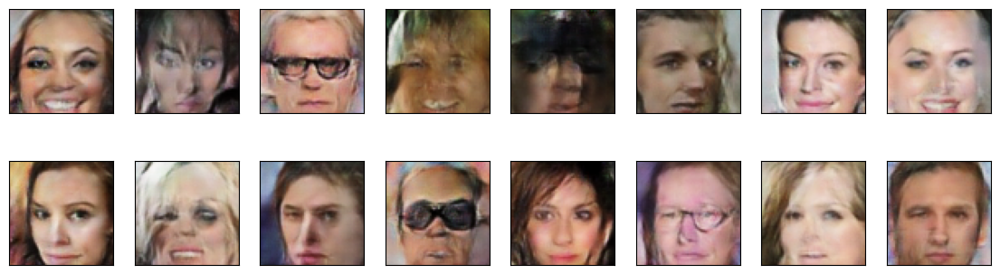

Epoch [   37/   50] | d_loss: 0.2469 | g_loss: 5.8288
Epoch [   37/   50] | d_loss: 0.0101 | g_loss: 4.9197
Epoch [   37/   50] | d_loss: 0.0318 | g_loss: 6.4998
Epoch [   37/   50] | d_loss: 0.0704 | g_loss: 5.0597
Epoch [   37/   50] | d_loss: 0.0458 | g_loss: 6.2560
Epoch [   37/   50] | d_loss: 0.1145 | g_loss: 3.3747
Epoch [   37/   50] | d_loss: 0.0493 | g_loss: 6.0993
Epoch [   37/   50] | d_loss: 0.0508 | g_loss: 4.6351
Epoch [   37/   50] | d_loss: 0.5191 | g_loss: 4.9279
Epoch [   37/   50] | d_loss: 0.1382 | g_loss: 5.3566
Epoch [   37/   50] | d_loss: 0.2310 | g_loss: 3.1936


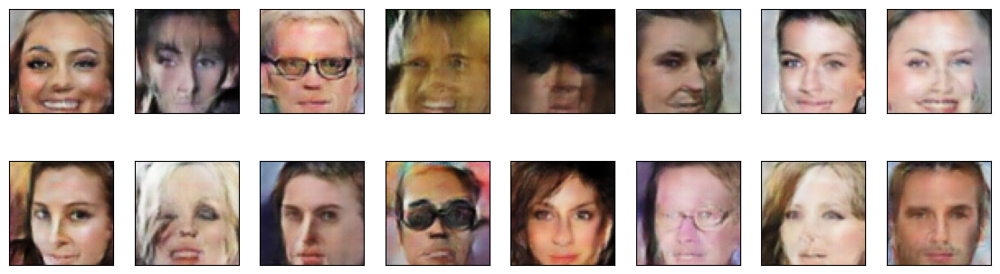

Epoch [   38/   50] | d_loss: 0.3330 | g_loss: 5.5720
Epoch [   38/   50] | d_loss: 0.0687 | g_loss: 5.4803
Epoch [   38/   50] | d_loss: 1.7934 | g_loss: 9.7211
Epoch [   38/   50] | d_loss: 0.0400 | g_loss: 4.8160
Epoch [   38/   50] | d_loss: 0.2263 | g_loss: 3.4315
Epoch [   38/   50] | d_loss: 0.0705 | g_loss: 5.0086
Epoch [   38/   50] | d_loss: 0.2009 | g_loss: 4.2797
Epoch [   38/   50] | d_loss: 0.5368 | g_loss: 4.8831
Epoch [   38/   50] | d_loss: 0.0584 | g_loss: 2.6297
Epoch [   38/   50] | d_loss: 0.0136 | g_loss: 6.3472
Epoch [   38/   50] | d_loss: 0.0386 | g_loss: 4.3124


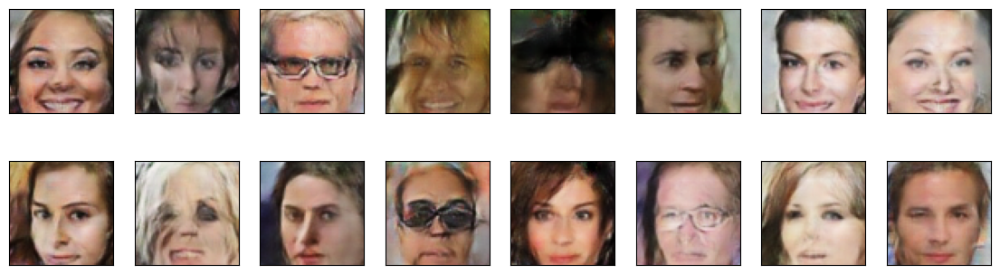

Epoch [   39/   50] | d_loss: 0.0112 | g_loss: 5.1525
Epoch [   39/   50] | d_loss: 0.3641 | g_loss: 4.6698
Epoch [   39/   50] | d_loss: 0.1752 | g_loss: 6.3423
Epoch [   39/   50] | d_loss: 0.1495 | g_loss: 7.7159
Epoch [   39/   50] | d_loss: 1.1718 | g_loss: 3.9242
Epoch [   39/   50] | d_loss: 0.6299 | g_loss: 2.5309
Epoch [   39/   50] | d_loss: 0.1016 | g_loss: 4.2201
Epoch [   39/   50] | d_loss: 0.1726 | g_loss: 4.7415
Epoch [   39/   50] | d_loss: 0.1709 | g_loss: 4.2623
Epoch [   39/   50] | d_loss: 0.1267 | g_loss: 5.6631
Epoch [   39/   50] | d_loss: 0.1300 | g_loss: 5.0714


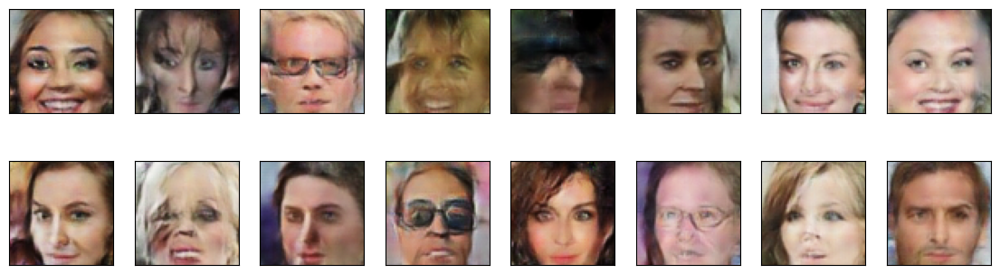

Epoch [   40/   50] | d_loss: 0.0377 | g_loss: 4.8745
Epoch [   40/   50] | d_loss: 0.0156 | g_loss: 6.6747
Epoch [   40/   50] | d_loss: 0.1430 | g_loss: 2.9240
Epoch [   40/   50] | d_loss: 0.1402 | g_loss: 2.8909
Epoch [   40/   50] | d_loss: 0.0692 | g_loss: 5.7503
Epoch [   40/   50] | d_loss: 0.0372 | g_loss: 9.2998
Epoch [   40/   50] | d_loss: 0.1062 | g_loss: 4.9729
Epoch [   40/   50] | d_loss: 0.0118 | g_loss: 5.8394
Epoch [   40/   50] | d_loss: 0.3374 | g_loss: 6.3894
Epoch [   40/   50] | d_loss: 0.0601 | g_loss: 5.5312
Epoch [   40/   50] | d_loss: 0.1010 | g_loss: 5.2592


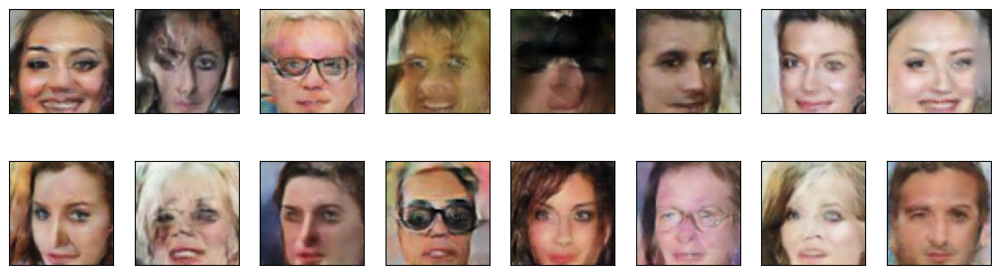

Epoch [   41/   50] | d_loss: 0.2328 | g_loss: 4.4119
Epoch [   41/   50] | d_loss: 0.0154 | g_loss: 5.2122
Epoch [   41/   50] | d_loss: 0.0255 | g_loss: 3.9309
Epoch [   41/   50] | d_loss: 0.1928 | g_loss: 2.3426
Epoch [   41/   50] | d_loss: 0.0377 | g_loss: 4.8159
Epoch [   41/   50] | d_loss: 0.0851 | g_loss: 4.1883
Epoch [   41/   50] | d_loss: 0.9969 | g_loss: 11.5390
Epoch [   41/   50] | d_loss: 0.1655 | g_loss: 5.2692
Epoch [   41/   50] | d_loss: 0.1062 | g_loss: 4.7146
Epoch [   41/   50] | d_loss: 0.0288 | g_loss: 7.0919
Epoch [   41/   50] | d_loss: 0.0502 | g_loss: 5.3711


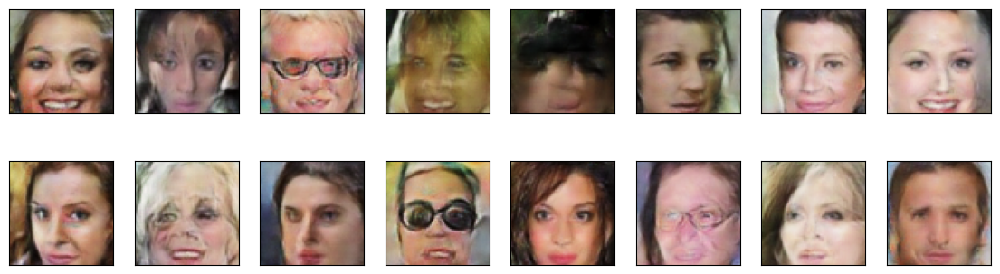

Epoch [   42/   50] | d_loss: 0.0303 | g_loss: 5.4614
Epoch [   42/   50] | d_loss: 0.0506 | g_loss: 5.6122
Epoch [   42/   50] | d_loss: 0.2349 | g_loss: 3.7813
Epoch [   42/   50] | d_loss: 0.1782 | g_loss: 5.7511
Epoch [   42/   50] | d_loss: 0.1148 | g_loss: 1.8226
Epoch [   42/   50] | d_loss: 0.9258 | g_loss: 2.2556
Epoch [   42/   50] | d_loss: 0.2761 | g_loss: 3.6816
Epoch [   42/   50] | d_loss: 0.4405 | g_loss: 4.9297
Epoch [   42/   50] | d_loss: 1.3548 | g_loss: 5.3212
Epoch [   42/   50] | d_loss: 0.0285 | g_loss: 6.6237
Epoch [   42/   50] | d_loss: 0.0402 | g_loss: 5.0768


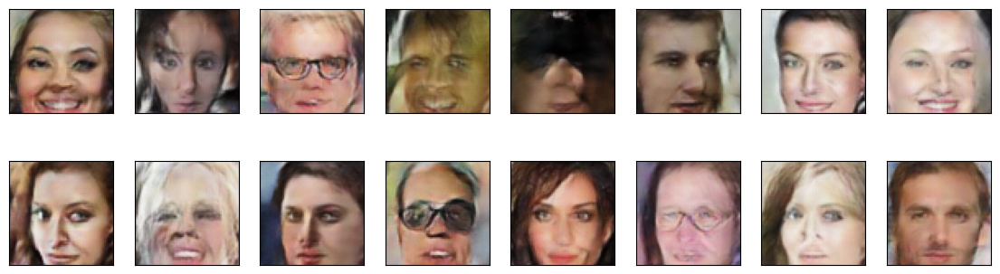

Epoch [   43/   50] | d_loss: 0.0479 | g_loss: 3.1138
Epoch [   43/   50] | d_loss: 0.2359 | g_loss: 3.4045
Epoch [   43/   50] | d_loss: 0.1217 | g_loss: 3.3560
Epoch [   43/   50] | d_loss: 0.1977 | g_loss: 4.6168
Epoch [   43/   50] | d_loss: 0.3254 | g_loss: 7.3033
Epoch [   43/   50] | d_loss: 0.5095 | g_loss: 4.4505
Epoch [   43/   50] | d_loss: 0.0254 | g_loss: 3.2147
Epoch [   43/   50] | d_loss: 0.2640 | g_loss: 3.6527
Epoch [   43/   50] | d_loss: 0.0522 | g_loss: 6.2108
Epoch [   43/   50] | d_loss: 0.3807 | g_loss: 9.9538
Epoch [   43/   50] | d_loss: 0.1715 | g_loss: 3.0221


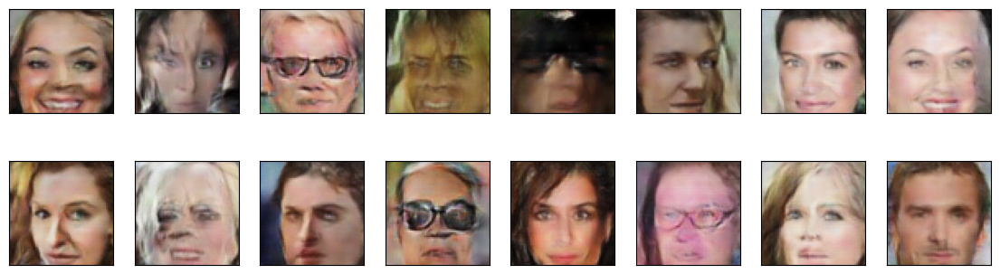

Epoch [   44/   50] | d_loss: 0.2677 | g_loss: 5.0916
Epoch [   44/   50] | d_loss: 0.0824 | g_loss: 5.8391
Epoch [   44/   50] | d_loss: 0.0937 | g_loss: 6.2615
Epoch [   44/   50] | d_loss: 0.0397 | g_loss: 7.2762
Epoch [   44/   50] | d_loss: 0.3843 | g_loss: 3.5450
Epoch [   44/   50] | d_loss: 0.0407 | g_loss: 2.2781
Epoch [   44/   50] | d_loss: 0.1165 | g_loss: 3.2500
Epoch [   44/   50] | d_loss: 0.3981 | g_loss: 8.8092
Epoch [   44/   50] | d_loss: 0.0271 | g_loss: 3.1775
Epoch [   44/   50] | d_loss: 0.0224 | g_loss: 6.1841
Epoch [   44/   50] | d_loss: 0.0125 | g_loss: 5.9618


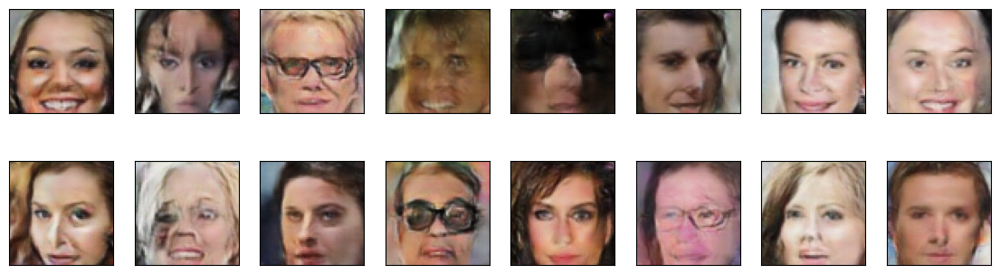

Epoch [   45/   50] | d_loss: 0.0290 | g_loss: 5.7390
Epoch [   45/   50] | d_loss: 0.7127 | g_loss: 5.9334
Epoch [   45/   50] | d_loss: 0.2819 | g_loss: 5.2370
Epoch [   45/   50] | d_loss: 0.3584 | g_loss: 3.0473
Epoch [   45/   50] | d_loss: 0.0782 | g_loss: 3.8261
Epoch [   45/   50] | d_loss: 0.3749 | g_loss: 3.9090
Epoch [   45/   50] | d_loss: 0.1398 | g_loss: 5.3892
Epoch [   45/   50] | d_loss: 0.0432 | g_loss: 5.8714
Epoch [   45/   50] | d_loss: 0.0587 | g_loss: 5.7854
Epoch [   45/   50] | d_loss: 0.3739 | g_loss: 6.1207
Epoch [   45/   50] | d_loss: 0.3716 | g_loss: 4.0487


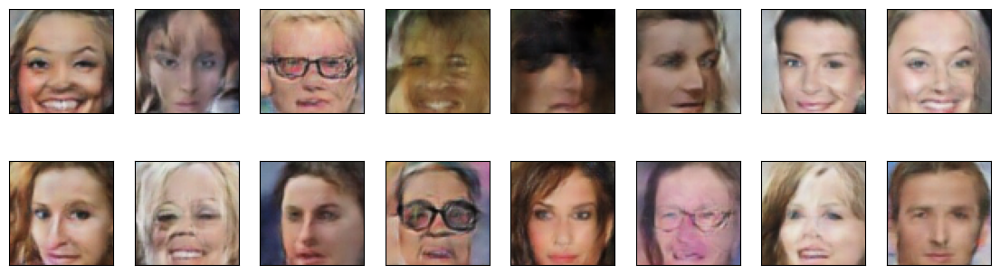

Epoch [   46/   50] | d_loss: 0.2445 | g_loss: 5.0567
Epoch [   46/   50] | d_loss: 0.2833 | g_loss: 5.3409
Epoch [   46/   50] | d_loss: 0.0465 | g_loss: 6.2959
Epoch [   46/   50] | d_loss: 0.1836 | g_loss: 4.1207
Epoch [   46/   50] | d_loss: 0.0591 | g_loss: 3.5341
Epoch [   46/   50] | d_loss: 0.0631 | g_loss: 6.2062
Epoch [   46/   50] | d_loss: 0.0577 | g_loss: 4.0127
Epoch [   46/   50] | d_loss: 0.4859 | g_loss: 3.2934
Epoch [   46/   50] | d_loss: 0.6225 | g_loss: 7.2603
Epoch [   46/   50] | d_loss: 0.4861 | g_loss: 2.6227
Epoch [   46/   50] | d_loss: 0.0364 | g_loss: 6.2902


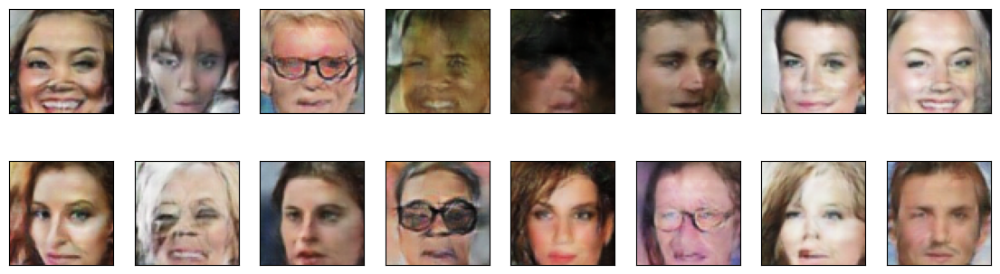

Epoch [   47/   50] | d_loss: 0.0777 | g_loss: 6.4593
Epoch [   47/   50] | d_loss: 0.0821 | g_loss: 3.9862
Epoch [   47/   50] | d_loss: 0.1156 | g_loss: 3.4404
Epoch [   47/   50] | d_loss: 0.0203 | g_loss: 7.2333
Epoch [   47/   50] | d_loss: 0.1240 | g_loss: 4.3024
Epoch [   47/   50] | d_loss: 0.0244 | g_loss: 6.2064
Epoch [   47/   50] | d_loss: 0.0248 | g_loss: 5.2934
Epoch [   47/   50] | d_loss: 2.2209 | g_loss: 2.1413
Epoch [   47/   50] | d_loss: 0.7419 | g_loss: 5.5231
Epoch [   47/   50] | d_loss: 0.0439 | g_loss: 3.3753
Epoch [   47/   50] | d_loss: 0.0774 | g_loss: 6.4416


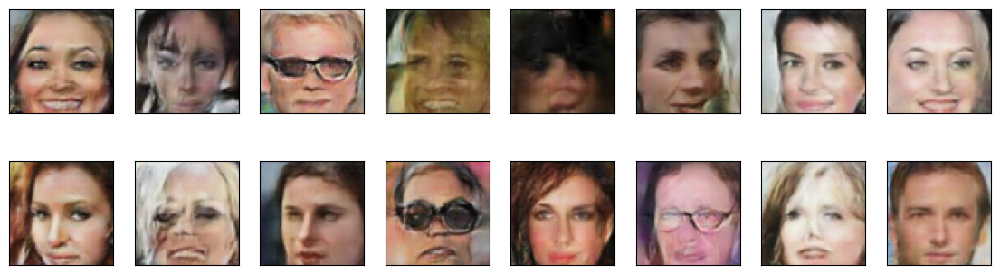

Epoch [   48/   50] | d_loss: 0.1575 | g_loss: 7.0254
Epoch [   48/   50] | d_loss: 0.3402 | g_loss: 5.0464
Epoch [   48/   50] | d_loss: 0.0326 | g_loss: 2.3506
Epoch [   48/   50] | d_loss: 0.1326 | g_loss: 6.2113
Epoch [   48/   50] | d_loss: 0.0421 | g_loss: 5.2767
Epoch [   48/   50] | d_loss: 0.0258 | g_loss: 6.5049
Epoch [   48/   50] | d_loss: 0.0637 | g_loss: 5.1621
Epoch [   48/   50] | d_loss: 1.2747 | g_loss: 7.0847
Epoch [   48/   50] | d_loss: 0.3733 | g_loss: 3.1040
Epoch [   48/   50] | d_loss: 0.3116 | g_loss: 7.8273
Epoch [   48/   50] | d_loss: 0.0406 | g_loss: 4.1172


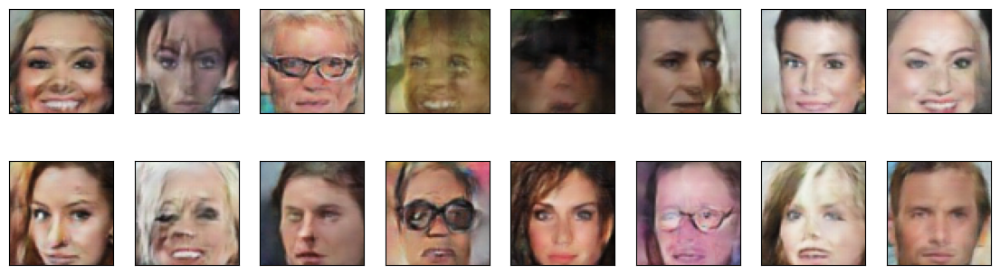

Epoch [   49/   50] | d_loss: 0.3155 | g_loss: 2.5476
Epoch [   49/   50] | d_loss: 0.0932 | g_loss: 6.8252
Epoch [   49/   50] | d_loss: 0.4748 | g_loss: 4.6050
Epoch [   49/   50] | d_loss: 0.3245 | g_loss: 5.1592
Epoch [   49/   50] | d_loss: 0.1619 | g_loss: 3.6225
Epoch [   49/   50] | d_loss: 0.1043 | g_loss: 6.8089
Epoch [   49/   50] | d_loss: 0.0674 | g_loss: 4.5788
Epoch [   49/   50] | d_loss: 0.1390 | g_loss: 4.1752
Epoch [   49/   50] | d_loss: 0.0289 | g_loss: 4.9404
Epoch [   49/   50] | d_loss: 0.4408 | g_loss: 2.8079
Epoch [   49/   50] | d_loss: 0.1872 | g_loss: 3.0079


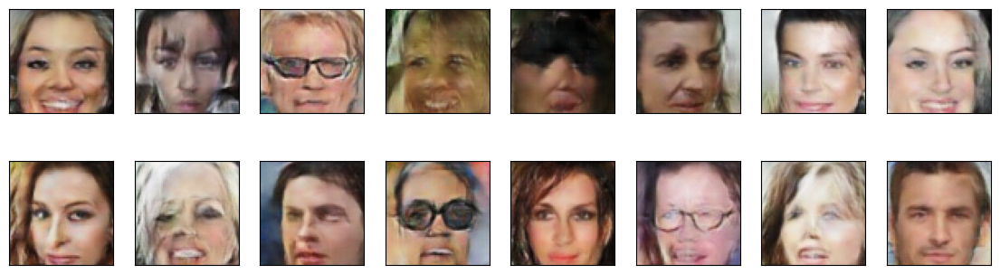

Epoch [   50/   50] | d_loss: 0.0925 | g_loss: 11.0339
Epoch [   50/   50] | d_loss: 0.0725 | g_loss: 4.1198
Epoch [   50/   50] | d_loss: 0.0334 | g_loss: 5.9608
Epoch [   50/   50] | d_loss: 0.0893 | g_loss: 5.9754
Epoch [   50/   50] | d_loss: 0.7551 | g_loss: 5.0872
Epoch [   50/   50] | d_loss: 0.0822 | g_loss: 5.8712
Epoch [   50/   50] | d_loss: 0.2179 | g_loss: 3.8951
Epoch [   50/   50] | d_loss: 0.0994 | g_loss: 6.4956
Epoch [   50/   50] | d_loss: 0.0932 | g_loss: 6.5834
Epoch [   50/   50] | d_loss: 0.1258 | g_loss: 4.1650
Epoch [   50/   50] | d_loss: 0.1865 | g_loss: 3.5554


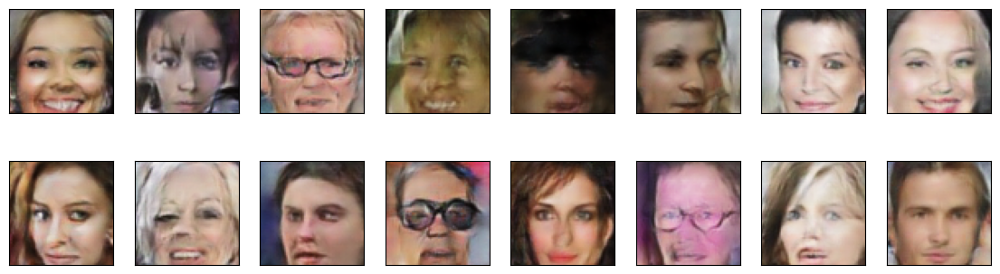

In [67]:
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()

losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)
        
        ####################################
        
        # TODO: implement the training strategy
        
        # ============================================
        #            TRAIN THE DISCRIMINATOR
        # ============================================
        
        d_optimizer.zero_grad()
        
        # 1. Train with real images

        # Compute the discriminator losses on real images 
        
        D_real = discriminator(real_images)
        d_real_loss = real_loss(D_real, device)
        
        # 2. Train with fake images
        
        # Generate fake images
        z = torch.randn(batch_size, latent_dim, 1, 1)
        # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
        # z = torch.from_numpy(z).float()
        z = z.to(device)
        
        fake_images = generator(z)
        
        # Compute the discriminator losses on fake images            
        D_fake = discriminator(fake_images)
        d_fake_loss = fake_loss(D_fake, device)
        
        # add up loss and perform backprop
        d_loss = d_real_loss + d_fake_loss
        d_loss.backward()
        
        d_optimizer.step()
        
        
        # =========================================
        #            TRAIN THE GENERATOR
        # =========================================
        g_optimizer.zero_grad()
        
        # 1. Train with fake images and flipped labels
        
        # Generate fake images
        z = torch.randn(batch_size, latent_dim, 1, 1)
        # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
        # z = torch.from_numpy(z).float()
        z = z.to(device)
        
        fake_images = generator(z)
        
        # Compute the discriminator losses on fake images 
        # using flipped labels!
        D_fake = discriminator(fake_images)
        g_loss = real_loss(D_fake, device) # use real loss to flip labels
        
        # perform backprop
        g_loss.backward()
        g_optimizer.step()

        # Print some loss stats
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            losses.append((d_loss.item(), g_loss.item()))
            # print discriminator and generator loss
            print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                    epoch+1, n_epochs, d_loss.item(), g_loss.item()))

            
        ####################################
        
        # if batch_i % print_every == 0:
        #     # append discriminator loss and generator loss
        #     d = d_loss['loss'].item()
        #     g = g_loss['loss'].item()
        #     losses.append((d, g))
        #     # print discriminator and generator loss
        #     time = str(datetime.now()).split('.')[0]
        #     print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()

### Training losses

Plot the training losses for the generator and discriminator.

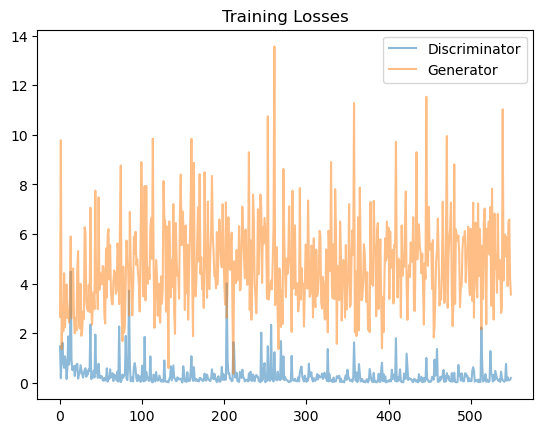

In [68]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.